In [7]:
!python -V
!pip --version
!python3 --version
!pip3 --version
!pip install --user --upgrade tensorflow 

Python 3.7.6
pip 20.0.2 from /opt/anaconda3/lib/python3.7/site-packages/pip (python 3.7)
Python 3.8.5
pip 20.1.1 from /Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/pip (python 3.8)
     |████████████████████████████████| 175.3 MB 20 kB/s  eta 0:00:013    |████▊                           | 25.6 MB 3.6 MB/s eta 0:00:42     |███████                         | 38.7 MB 41.0 MB/s eta 0:00:04     |██████████                      | 54.9 MB 7.6 MB/s eta 0:00:16     |██████████▍                     | 56.8 MB 7.6 MB/s eta 0:00:16     |███████████▊                    | 64.1 MB 3.9 MB/s eta 0:00:29     |████████████                    | 65.1 MB 3.9 MB/s eta 0:00:29     |████████████▏                   | 66.7 MB 3.9 MB/s eta 0:00:29     |█████████████▏                  | 72.1 MB 3.9 MB/s eta 0:00:27     |█████████████▌                  | 74.1 MB 2.6 MB/s eta 0:00:40     |██████████████▊                 | 80.8 MB 2.6 MB/s eta 0:00:37     |██████████████▉                

  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.


In [7]:
!conda install -c conda-forge tensorflow -y

Solving environment: done

# All requested packages already installed.



In [2]:
!conda install mahotas -y
!conda install -c anaconda scikit-image -y
!conda install -c anaconda scikit-learn -y
!conda install matplotlib -y

Solving environment: done

# All requested packages already installed.

Solving environment: done

## Package Plan ##

  environment location: /opt/anaconda3/envs/tf

  added / updated specs:
    - scikit-image


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    certifi-2020.6.20          |           py37_0         159 KB  anaconda
    cycler-0.10.0              |           py37_0          14 KB  anaconda
    cytoolz-0.10.1             |   py37h1de35cc_0         362 KB  anaconda
    freetype-2.10.2            |       ha233b18_0         876 KB  anaconda
    kiwisolver-1.2.0           |   py37h04f5b5a_0          61 KB  anaconda
    matplotlib-3.2.2           |                0          20 KB  anaconda
    matplotlib-base-3.2.2      |   py37h5670ca0_0         7.1 MB  anaconda
    olefile-0.46               |           py37_0          48 KB  anaconda
    pillow-7.2.0               |   py37ha54

In [150]:
import numpy as np
import pylab
import mahotas as mh
import matplotlib
import matplotlib.pyplot as plt
import tensorflow as tf

from tensorflow import keras
from skimage import filters
from os import listdir
from os.path import isfile, join
from PIL import Image

## Create paths

In [151]:
# file = {'num': '001', 'type': 74}
# img_type = {'cell'}
# filename = '{num}{type}.tiff'.format(**person)
mypath = './TMI2015/testing/'
onlyfiles = [f for f in listdir(mypath) if isfile(join(mypath, f))]
onlyfiles_base = [f for f in onlyfiles if (not ('_' in f)) and '.tif' in f]
onlyfiles_base.sort()
# print(onlyfiles_base)
# save to ./formatted_images/

for imname in onlyfiles_base:
# Create image filenames ----
    img_raw_path = imname
    img_cell_path = imname.replace('.','_cell.')
    img_block_path = imname.replace('.','_block.')
    #     print(img_raw_path,img_block_path,img_cell_path)
    
# Read Images ----
    img_raw   = mh.imread(join(mypath,img_raw_path))
    img_cell  = mh.imread(join(mypath,img_cell_path))
    img_block = mh.imread(join(mypath,img_block_path))
    
# Crop and Format Images ----
    # find indices of boundary square in block image
    x = np.sum(img_block,axis = 2).nonzero()
    # Extract important corners
    mL = x[0].min() # row low
    nL = x[1].min() # col low
    
    # I hardcoded size (counts as width and height) to ensure there's a standard size and no errors downstream
    size = 416
    mH = mL+size # x[0].max() # row high
    nH = nL+size # x[1].max() # col high
    
    #summed all 4 pages of image 
    img_cell_2D = np.sum(img_cell,axis = 2) 
    img_cell_crop = img_cell_2D[mL:mH,nL:nH] # 1 channel image
    img_raw_crop = img_raw[mL:mH,nL:nH,...] # 4 channel RGBA image
    
    # break if no cells in image
    nar = np.array((img_cell_crop.nonzero()[1]))
    if nar.size == 0:
        print('broken image')
        assert()
    #convert to 0 or 255 binary
    img_cell_crop_binary = (img_cell_crop>0)*255
    
    #final formatting
    mask = Image.fromarray(np.uint8(img_cell_crop_binary))
    image = Image.fromarray(np.uint8(img_raw_crop))
    # Create paths
    image_path = join('formatted_images/images/',img_raw_path)
    mask_path = join('formatted_images/masks/',img_cell_path)
    
# Save Images ----
    image.save(image_path, format='TIFF')
    mask.save(mask_path, format='TIFF')
    

broken image


AssertionError: 

In [152]:
# print(x[0].min())
print(imname)
img_cell.nonzero()
img_cell_flat = np.sum(img_cell,axis = 2)

print(img_cell.shape)
print(img_cell_flat.shape) 
print(np.all(img_cell_flat>=img_cell[...,3]))
print(np.sum(img_cell[...,3]))
assert()
print(nar.size==0)

335.tif
(2200, 2200, 4)
(2200, 2200)
True
198645


AssertionError: 

In [ ]:
print('hi')

# Keras Section
based on https://keras.io/examples/vision/oxford_pets_image_segmentation/

In [153]:
import os

# Image directory
input_dir = "formatted_images/images"
# mask dir
target_dir = "formatted_images/masks"
img_size = (416, 416)
num_classes = 1
batch_size = 6

input_img_paths = sorted(
    [
        os.path.join(input_dir, fname)
        for fname in os.listdir(input_dir)
        if fname.endswith(".tif")
    ]
)
target_img_paths = sorted(
    [
        os.path.join(target_dir, fname)
        for fname in os.listdir(target_dir)
        if fname.endswith(".tif") and not fname.startswith(".")
    ]
)

print("Number of samples:", len(input_img_paths))

for input_path, target_path in zip(input_img_paths[:10], target_img_paths[:10]):
    print(input_path, "|", target_path)


Number of samples: 334
formatted_images/images/001.tif | formatted_images/masks/001_cell.tif
formatted_images/images/002.tif | formatted_images/masks/002_cell.tif
formatted_images/images/003.tif | formatted_images/masks/003_cell.tif
formatted_images/images/004.tif | formatted_images/masks/004_cell.tif
formatted_images/images/005.tif | formatted_images/masks/005_cell.tif
formatted_images/images/006.tif | formatted_images/masks/006_cell.tif
formatted_images/images/007.tif | formatted_images/masks/007_cell.tif
formatted_images/images/008.tif | formatted_images/masks/008_cell.tif
formatted_images/images/009.tif | formatted_images/masks/009_cell.tif
formatted_images/images/010.tif | formatted_images/masks/010_cell.tif


## Display example image

(416, 416, 4)


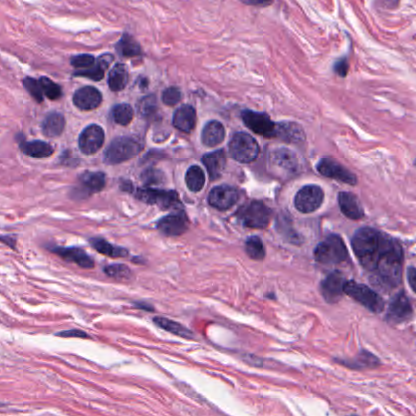

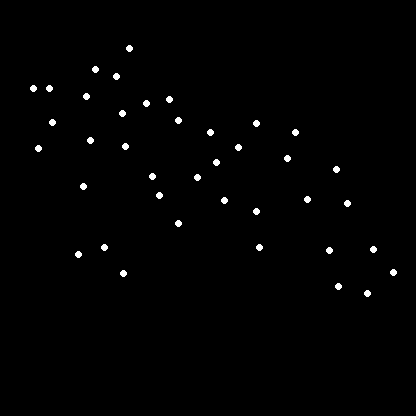

(416, 416)


In [154]:
from IPython.display import Image, display
from tensorflow.keras.preprocessing.image import load_img
import PIL
from PIL import ImageOps

# Display input image #7
p = PIL.Image.open(input_img_paths[9])
print(np.asarray(p).shape)
# Display auto-contrast version of corresponding target (per-pixel categories)
p2 = PIL.Image.open(target_img_paths[9])
display(p)
display(p2)
print(np.asarray(p2).shape)

In [155]:
from tensorflow import keras
import numpy as np
from tensorflow.keras.preprocessing.image import load_img


class HEcells(keras.utils.Sequence):
    #     formerly oxford cells
    """Helper to iterate over the data (as Numpy arrays)."""

    def __init__(self, batch_size, img_size, input_img_paths, target_img_paths):
        self.batch_size = batch_size
        self.img_size = img_size
        self.input_img_paths = input_img_paths
        self.target_img_paths = target_img_paths

    def __len__(self):
        return len(self.target_img_paths) // self.batch_size

    def __getitem__(self, idx):
        """Returns tuple (input, target) correspond to batch #idx."""
        i = idx * self.batch_size
        batch_input_img_paths = self.input_img_paths[i : i + self.batch_size]
        batch_target_img_paths = self.target_img_paths[i : i + self.batch_size]
        x = np.zeros((batch_size,) + self.img_size + (3,), dtype="float32")
        for j, path in enumerate(batch_input_img_paths):
            img = load_img(path, target_size=self.img_size)
            x[j] = img
        y = np.zeros((batch_size,) + self.img_size + (1,), dtype="uint8")
        for j, path in enumerate(batch_target_img_paths):
            img = load_img(path, target_size=self.img_size, color_mode="grayscale")
            y[j] = np.expand_dims(img, 2)
        return x, y


## Define UNet
As recomended by Olaf Ronneberger et al.[1] and known for working well off small amounts of targeted data

1. [U-Net: Convolutional Networks for Biomedical Image Segmentation.][id]
[id]: https://arxiv.org/abs/1505.04597 "U-Net: Convolutional Networks for Biomedical Image Segmentation."

In [156]:
from tensorflow.keras import layers


def get_model(img_size, num_classes):
    #outputs model object
    inputs = keras.Input(shape=img_size + (3,))

    ### [First half of the network: downsampling inputs] ###

    # Entry block
    x = layers.Conv2D(32, 3, strides=2, padding="same")(inputs)
    x = layers.BatchNormalization()(x)
    x = layers.Activation("relu")(x)

    previous_block_activation = x  # Set aside residual

    # Blocks 1, 2, 3 are identical apart from the feature depth.
    for filters in [64, 128, 256]:
        x = layers.Activation("relu")(x)
        x = layers.SeparableConv2D(filters, 3, padding="same")(x)
        x = layers.BatchNormalization()(x)

        x = layers.Activation("relu")(x)
        x = layers.SeparableConv2D(filters, 3, padding="same")(x)
        x = layers.BatchNormalization()(x)

        x = layers.MaxPooling2D(3, strides=2, padding="same")(x)

        # Project residual
        residual = layers.Conv2D(filters, 1, strides=2, padding="same")(
            previous_block_activation
        )
        x = layers.add([x, residual])  # Add back residual
        previous_block_activation = x  # Set aside next residual

    ### [Second half of the network: upsampling inputs] ###

    previous_block_activation = x  # Set aside residual

    for filters in [256, 128, 64, 32]:
        x = layers.Activation("relu")(x)
        x = layers.Conv2DTranspose(filters, 3, padding="same")(x)
        x = layers.BatchNormalization()(x)

        x = layers.Activation("relu")(x)
        x = layers.Conv2DTranspose(filters, 3, padding="same")(x)
        x = layers.BatchNormalization()(x)

        x = layers.UpSampling2D(2)(x)

        # Project residual
        residual = layers.UpSampling2D(2)(previous_block_activation)
        residual = layers.Conv2D(filters, 1, padding="same")(residual)
        x = layers.add([x, residual])  # Add back residual
        previous_block_activation = x  # Set aside next residual

    # Add a per-pixel classification layer
    outputs = layers.Conv2D(num_classes, 3, activation="softmax", padding="same")(x)

    # Define the model
    model = keras.Model(inputs, outputs)
    return model


# Free up RAM in case the model definition cells were run multiple times
keras.backend.clear_session()

# Build model
model = get_model(img_size, num_classes)
model_checkpoint = tf.keras.callbacks.ModelCheckpoint('cell_counting.hdf5', monitor='loss', save_best_only=True)
model.summary()


Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 416, 416, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 208, 208, 32) 896         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 208, 208, 32) 128         conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 208, 208, 32) 0           batch_normalization[0][0]        
______________________________________________________________________________________________

## Possible Alternative model 
By Author [Weidi Xie][github]

FCRN Model suggested in [Improving Nuclei Classification Performance in H&E Stained Tissue Images Using Fully Convolutional Regression Network and Convolutional Neural Network][id1] and [Microscopy Cell Counting with Fully Convolutional Regression Networks][id2]

[github]: https://github.com/WeidiXie/cell_counting_v2 "GitHub WiediXie"
[id1]: https://ieeexplore-ieee-org.proxy.library.upenn.edu/document/8707397 
[id2]: http://www.robots.ox.ac.uk/~vgg/publications/2015/Xie15/weidi15.pdf

### links
1. https://github.com/WeidiXie/cell_counting_v2
* https://ieeexplore-ieee-org.proxy.library.upenn.edu/document/8707397 
* http://www.robots.ox.ac.uk/~vgg/publications/2015/Xie15/weidi15.pdf

In [157]:
# from model_FCRN import buildModel_FCRN_A_v2
# model = buildModel_FCRN_A_v2(input_dim = img_size + (3,))
# model_checkpoint = ModelCheckpoint('cell_counting.hdf5', monitor='loss', save_best_only=True)
# model.summary()

## Testing set (this tutorial calls it validation)

In [158]:
len(input_img_paths)
print(5//2)

2


In [159]:
import random

# Split our img paths into a training and a validation set
# train-test-val split is 70,15,15
val_samples = int(len(input_img_paths)*.30)
print('Number of Test samples:', val_samples)
print('Number of Training samples:', len(input_img_paths)-val_samples)

#reproducible shuffle
random.Random(1337).shuffle(input_img_paths)
random.Random(1337).shuffle(target_img_paths)

# create paths
train_input_img_paths = input_img_paths[:-val_samples]
train_target_img_paths = target_img_paths[:-val_samples]
val_input_img_paths_tmp = input_img_paths[-val_samples:]
val_target_img_paths_tmp = target_img_paths[-val_samples:]

#split tmp val set into val and test
split_index = len(val_input_img_paths_tmp)//2
test_input_img_paths  = val_input_img_paths_tmp[:split_index]
test_target_img_paths = val_target_img_paths_tmp[:split_index]
val_input_img_paths   = val_input_img_paths_tmp[split_index:] 
val_target_img_paths  = val_target_img_paths_tmp[split_index:]


# Instantiate data Sequences for each split
train_gen = HEcells(batch_size, img_size, train_input_img_paths, train_target_img_paths)
val_gen = HEcells(batch_size, img_size, val_input_img_paths, val_target_img_paths)
test_gen = HEcells(batch_size, img_size, test_input_img_paths, test_target_img_paths)




Number of Test samples: 100
Number of Training samples: 234


## Training the model
If I had more computational power (i.e. could do this for more epochs) I would add:
1. **Transfer Learning on larger non-medical datasets**
    * UNet performs better on small amounts of data when it pre-trained
1. **Patience**
2. **Learning rate reduction after ~20% of patience**
3. **Parameter optimization to determine best optimizer and loss**

In [160]:
# Configure the model for training.
# We use the "sparse" version of categorical_crossentropy
# because our target data is integers.
model.compile(optimizer="rmsprop", loss="categorical_crossentropy")

callbacks = [
    keras.callbacks.ModelCheckpoint("oxford_segmentation.h5", save_best_only=True)
]

# Train the model, doing validation at the end of each epoch.
epochs = 40
model.fit(train_gen, epochs=epochs, validation_data=val_gen, callbacks=callbacks)


Epoch 1/15
39/39 [==============================] - 424s 11s/step - loss: 2.8641e-07 - val_loss: 3.0882e-07
Epoch 2/15
39/39 [==============================] - 477s 12s/step - loss: 2.8641e-07 - val_loss: 3.0882e-07
Epoch 3/15
39/39 [==============================] - 401s 10s/step - loss: 2.8641e-07 - val_loss: 3.0882e-07
Epoch 4/15
39/39 [==============================] - 279s 7s/step - loss: 2.8641e-07 - val_loss: 3.0882e-07
Epoch 5/15
39/39 [==============================] - 277s 7s/step - loss: 2.8641e-07 - val_loss: 3.0882e-07
Epoch 6/15
39/39 [==============================] - 271s 7s/step - loss: 2.8641e-07 - val_loss: 3.0882e-07
Epoch 7/15
39/39 [==============================] - 296s 8s/step - loss: 2.8641e-07 - val_loss: 3.0882e-07
Epoch 8/15
39/39 [==============================] - 339s 9s/step - loss: 2.8641e-07 - val_loss: 3.0882e-07
Epoch 9/15
39/39 [==============================] - 387s 10s/step - loss: 2.8641e-07 - val_loss: 3.0882e-07
Epoch 10/15
39/39 [==============

In [165]:
# Generate predictions for all images in the test set

# test_gen
test_preds = model.predict(test_gen)
print('Done predictions')

Done predictions


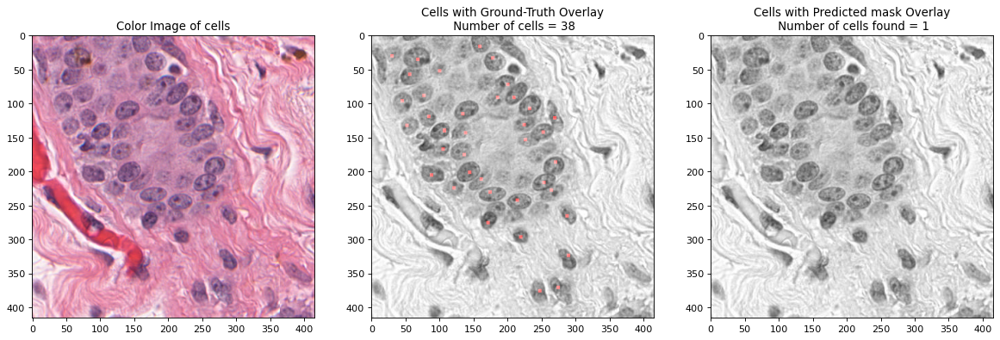

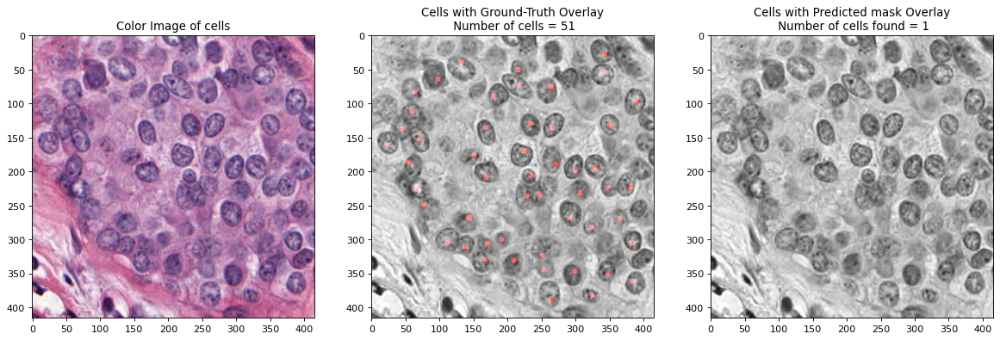

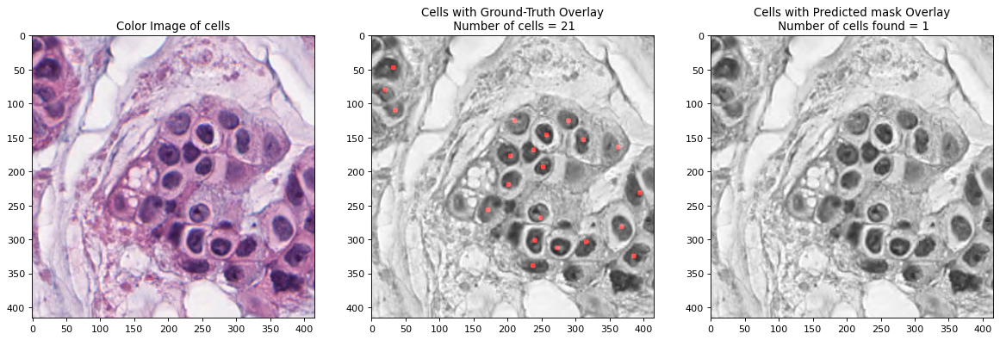

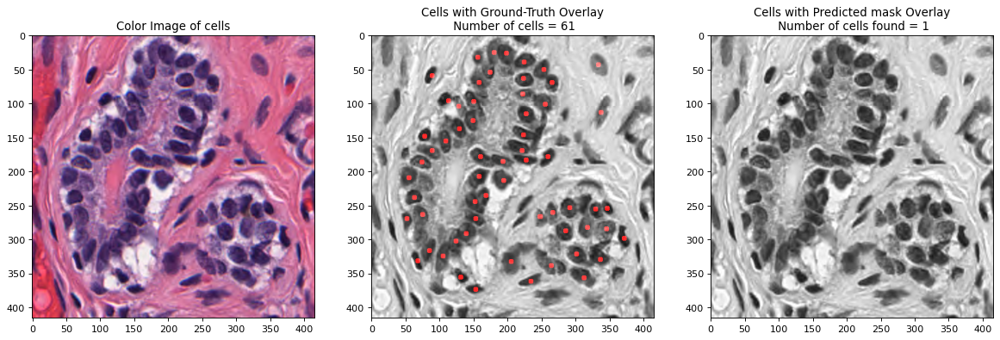

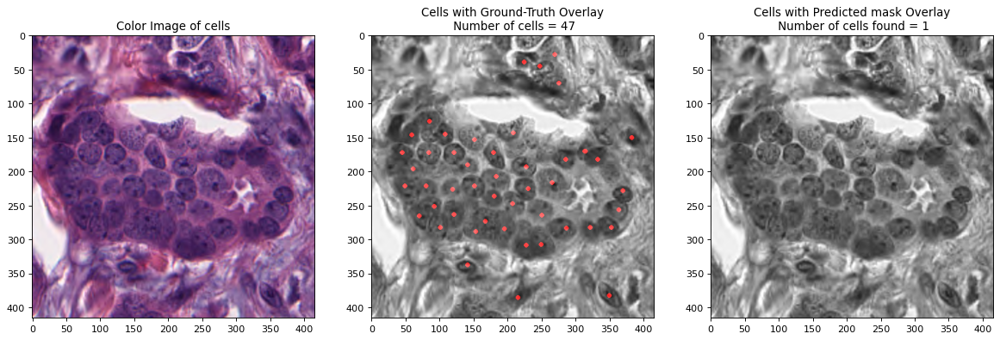

...

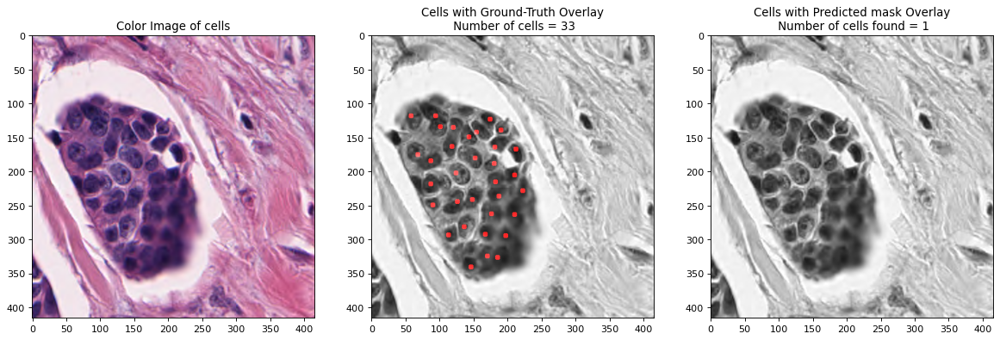

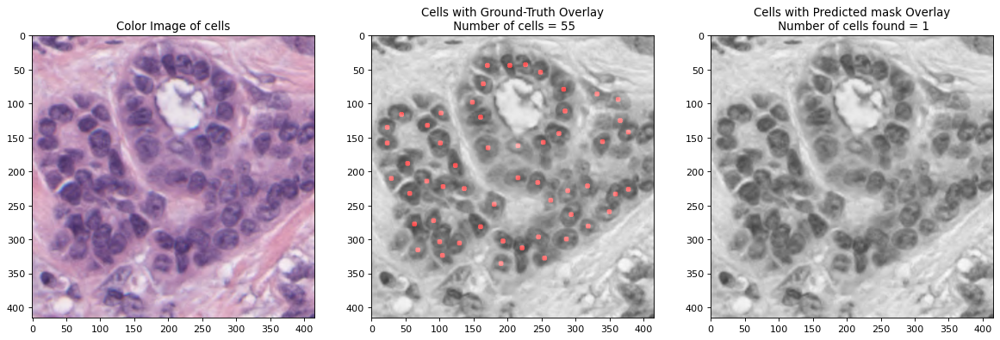

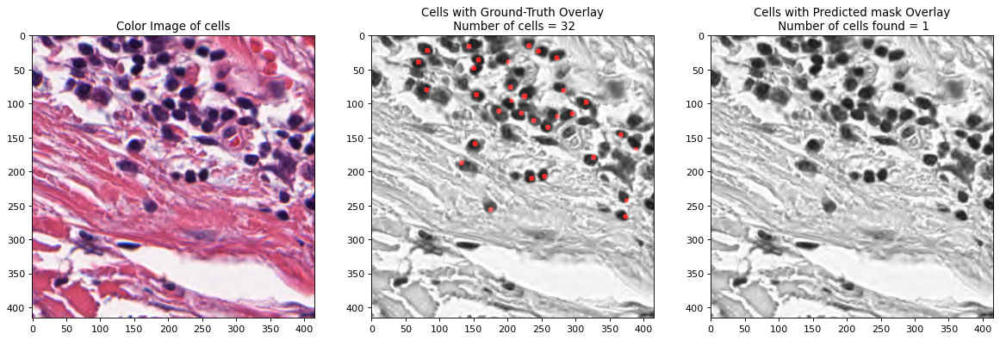

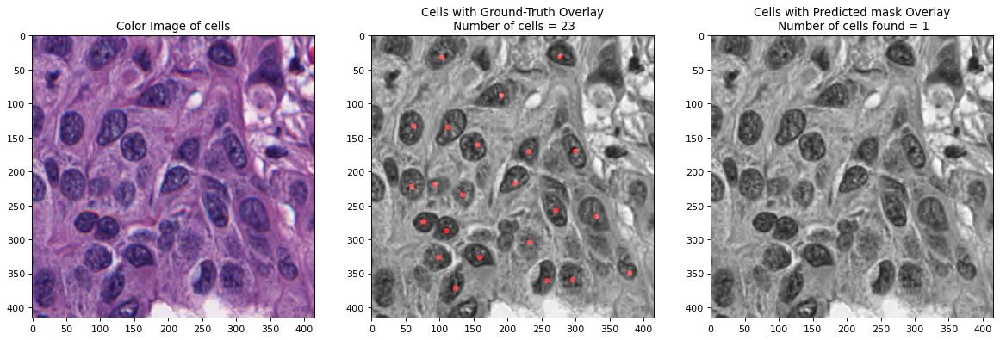

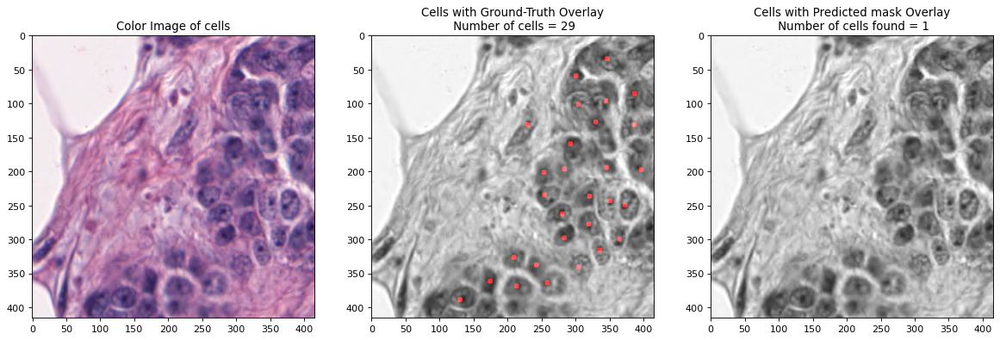

In [170]:
# Display test image results 
def display_mask(i):
    """Quick utility to display a model's prediction."""
    mask = np.argmax(test_preds[i], axis=-1)
    mask = np.expand_dims(mask, axis=-1)
    img = PIL.ImageOps.autocontrast(keras.preprocessing.image.array_to_img(mask))
    return img


# Display results for test image #10
title = './deliverables/results_15_epochs/results_15_epochs_n{}.png'
for i in range(len(test_preds)):
# Load Images ----
    # Display input image
    # add np.asarray(...) ?
    InputImage = np.asarray(PIL.Image.open(val_input_img_paths[i]))
    # Display ground-truth target mask
    mask_GT = np.asarray(PIL.Image.open(val_target_img_paths[i]))
    # Display mask predicted by our model
    mask_pred = np.asarray(display_mask(i))  # Note that the model only sees inputs at 150x150.
    
# Count cells ----    
    # For ground truth
    rmax_GT = mh.regmax(mask_GT)
    seeds_GT,nr_nuclei_GT = mh.label(rmax_GT)
    # print nr_nuclei_GT
    
    # For predictions
    rmax_pred = mh.regmax(mask_pred)
    seeds_pred,nr_nuclei_pred = mh.label(rmax_pred)
    # print nr_nuclei_pred
    
    
# Begin Plotting ----
    pylab.figure(figsize=(18, 16), dpi= 80, facecolor='w', edgecolor='k')
    
    # Color image of cells
    plt.subplot(131)
    pylab.title('Color Image of cells')
    pylab.imshow(InputImage)
    
    # Cells with groundtruth overlay
    plt.subplot(132)
    pylab.title('Cells with Ground-Truth Overlay\n Number of cells = '+str(nr_nuclei_GT))
    try:
        overlayed_image_GT = mh.overlay(InputImage[...,0],mask_GT)
        pylab.imshow(overlayed_image_GT)
    except:
        pass    
    plt.subplot(133)
    
    pylab.title('Cells with Predicted mask Overlay\n Number of cells found = '+str(nr_nuclei_pred))
    try:
        overlayed_image_pred = mh.overlay(InputImage[...,0],mask_pred)
        pylab.imshow(overlayed_image_pred)
    except:
        pass
    
    
    
    
    plt.savefig(title.format(str(i)), dpi=80)
    pylab.show()

In [167]:
try:
    assert()
except:
    pass
print('hi')

hi


## Scratch

In [161]:
# 0
print('img_cell_crop.shape',img_cell_crop.shape)

img_cell_crop_binary = (img_cell_crop>0)*255
print(img_cell_crop_binary.min())
w,h = 405,405

# 1
img_raw   = mh.imread(join(mypath,img_raw))
img_cell  = mh.imread(join(mypath,img_cell))
img_block = mh.imread(join(mypath,img_block))

# 2
print(img_raw.shape)
print(img_cell.shape)
print(img_block.shape)

pylab.figure(figsize=(18, 16), dpi= 80, facecolor='w', edgecolor='k')
plt.subplot(141)
pylab.imshow(img_raw)
plt.subplot(142)
pylab.imshow(img_cell[...,2])
plt.subplot(143)
pylab.imshow(img_block[...,0])
plt.subplot(144)
overlayed_image = mh.overlay(img_raw[...,0],img_cell[...,2],img_block[...,0])
pylab.imshow(overlayed_image)

pylab.show()

# 3
x = img_block[...,0].nonzero()
print(len(x))
print(x)
print(x[0].squeeze().shape)
print(x[0].max())
mH = x[0].max()
mL = x[0].min()
nH = x[1].max()
nL = x[1].min()
print(mL,mH,nL,nH)

img_cell_crop = img_cell[mL:mH,nL:nH,0]
img_raw_crop = img_raw[mL:mH,nL:nH,:3]

overlayed_image = mh.overlay(img_raw_crop[...,0],img_cell_crop)
pylab.imshow(overlayed_image)
pylab.show()

img_cell_crop.shape (416, 416)
0


TypeError: join() argument must be str or bytes, not 'ndarray'